<a href="https://colab.research.google.com/github/SanjanaPushpita/Dectron2_pretrain/blob/main/Detectron2_custom_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Install dependencies
!pip install -U torch torchvision
!pip install opencv-python

# Install Detectron2
# Install the pre-built version specific to the current PyTorch version:
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

# Verify installation by importing Detectron2
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Check if it was installed correctly
import torch, torchvision
print(f"Torch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

# Test a simple import from Detectron2 and OpenCV
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
import cv2
print("Detectron2 and OpenCV are ready to use!")


  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-4_xed_z9
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-4_xed_z9
  Resolved https://github.com/facebookresearch/detectron2.git to commit 8d85329aed8506ea3672e3e208971345973ea761
  Preparing metadata (setup.py) ... done
Torch version: 2.5.0+cu124
CUDA available: True
Detectron2 and OpenCV are ready to use!


In [2]:
import zipfile

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# import shutil

# # Define the source and destination paths
# src = '/content/drive/MyDrive/Dental/Dataset/Pediatric dental disease detection dataset'
# dst = '/content/Pediatric_dental_disease_detection_dataset'

# # Copy the folder
# shutil.copytree(src, dst)

In [4]:
import os
# Define the paths to your zip files
children_dental_dataset = '/content/drive/MyDrive/Dental dataset.zip'

# Unzipping the files to a specific directory (e.g., '/content/Children_Dental')
os.system(f'unzip "{children_dental_dataset}" -d /content/Children_Dental')

256

In [5]:
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.data.datasets import register_coco
from detectron2 import model_zoo

import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
%matplotlib inline

from detectron2.structures import BoxMode
from detectron2.data import DatasetCatalog, MetadataCatalog

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()


from google.colab.patches import cv2_imshow



In [6]:
def cv2_imshow(im):
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    plt.figure(), plt.imshow(im), plt.axis('off');

In [7]:
def dental_dataset(img_dir):
    json_file = os.path.join(img_dir, "annotations.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]
        objs = []
        for _, anno in annos.items():
            assert not anno["region_attributes"]
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

# Register the dataset with the new class names
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/Children_Dental/Children's dental caries segmentation dataset/Train/annotations.json", "/content/Children_Dental/Children's dental caries segmentation dataset/Train/images")
register_coco_instances("my_dataset_test", {}, "/content/Children_Dental/Children's dental caries segmentation dataset/Test/annotations.json", "/content/Children_Dental/Children's dental caries segmentation dataset/Test/images")


[10/18 14:19:46 d2.data.datasets.coco]: Loaded 70 images in COCO format from /content/Children_Dental/Children's dental caries segmentation dataset/Train/annotations.json


/usr/local/lib/python3.10/dist-packages/detectron2/utils/visualizer.py:318: UserWarning: Glyph 40843 (\N{CJK UNIFIED IDEOGRAPH-9F8B}) missing from current font.
  s, (width, height) = canvas.print_to_buffer()
/usr/local/lib/python3.10/dist-packages/detectron2/utils/visualizer.py:318: UserWarning: Glyph 40831 (\N{CJK UNIFIED IDEOGRAPH-9F7F}) missing from current font.
  s, (width, height) = canvas.print_to_buffer()
/usr/local/lib/python3.10/dist-packages/detectron2/utils/visualizer.py:318: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from current font.
  s, (width, height) = canvas.print_to_buffer()
/usr/local/lib/python3.10/dist-packages/detectron2/utils/visualizer.py:318: UserWarning: Glyph 21106 (\N{CJK UNIFIED IDEOGRAPH-5272}) missing from current font.
  s, (width, height) = canvas.print_to_buffer()


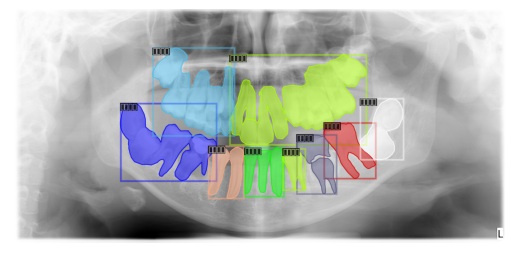

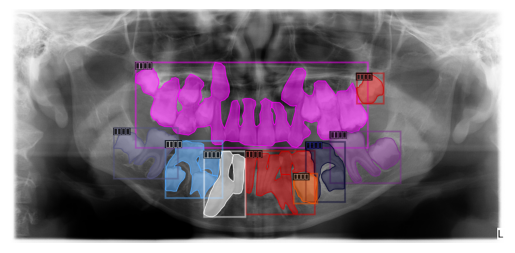

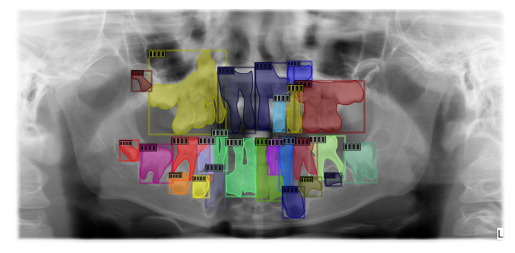

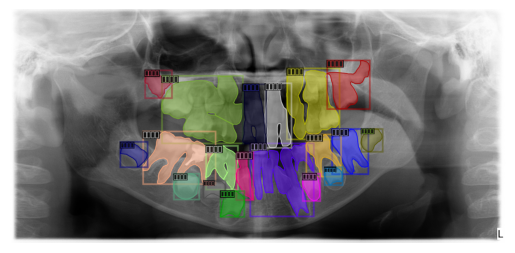

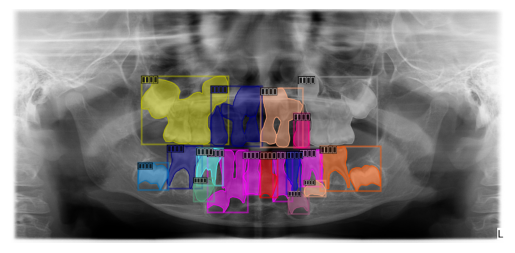

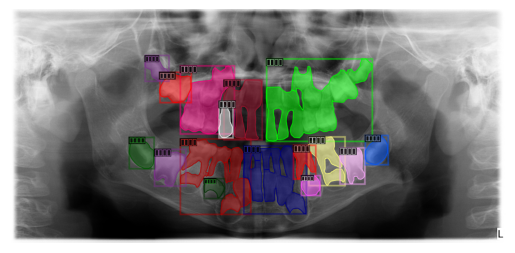

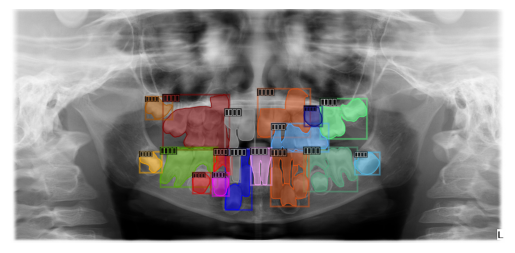

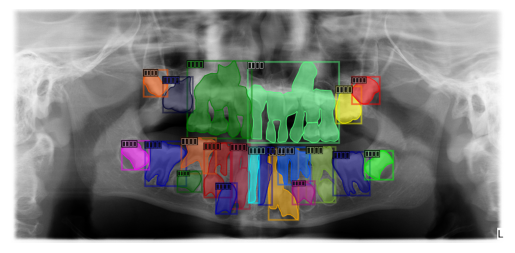

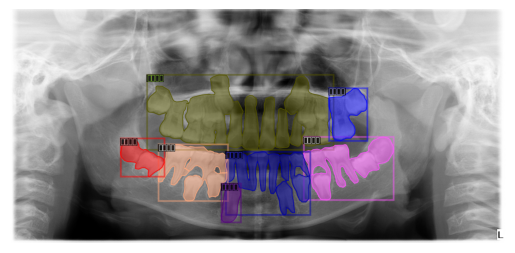

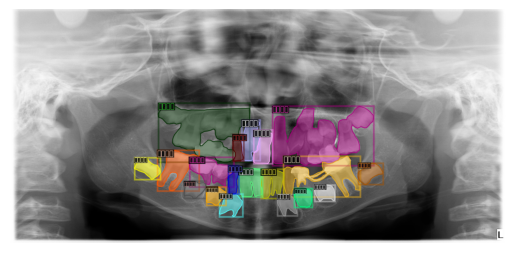

In [8]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [9]:
import os
import json
import cv2
import numpy as np
from detectron2.structures import BoxMode
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances
import random
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow  # Use this if you're in Google Colab

# Map Chinese class names to English
CLASS_NAME_MAPPING = {
    "牙齿发育异常": "Tooth Development Abnormality",
    "龋病": "Caries",
    "根尖周炎": "Periapical Periodontitis",
    "深窝沟": "Deep Pit and Fissure",
    "牙髓炎": "Pulpitis",
    "其他": "Others"
}

def dental_dataset(img_dir):
    json_file = os.path.join(img_dir, "annotations.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]
        objs = []
        for _, anno in annos.items():
            assert not anno["region_attributes"]
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            # Map Chinese class names to English class names using the mapping dictionary
            category_name = anno.get("category_name", "其他")  # Default to "其他" (Others) if not found
            category_id = list(CLASS_NAME_MAPPING.keys()).index(category_name)

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": category_id,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

# Remove existing registrations if they exist
if "my_dataset_train" in DatasetCatalog.list():
    DatasetCatalog.remove("my_dataset_train")
    MetadataCatalog.remove("my_dataset_train")

if "my_dataset_test" in DatasetCatalog.list():
    DatasetCatalog.remove("my_dataset_test")
    MetadataCatalog.remove("my_dataset_test")

# Register the dataset without altering thing_classes
register_coco_instances(
    "my_dataset_train",
    {},
    "/content/Children_Dental/Children's dental caries segmentation dataset/Train/annotations.json",
    "/content/Children_Dental/Children's dental caries segmentation dataset/Train/images"
)

register_coco_instances(
    "my_dataset_test",
    {},
    "/content/Children_Dental/Children's dental caries segmentation dataset/Test/annotations.json",
    "/content/Children_Dental/Children's dental caries segmentation dataset/Test/images"
)

# Get metadata and dataset dictionaries
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")




[10/18 14:19:56 d2.data.datasets.coco]: Loaded 70 images in COCO format from /content/Children_Dental/Children's dental caries segmentation dataset/Train/annotations.json


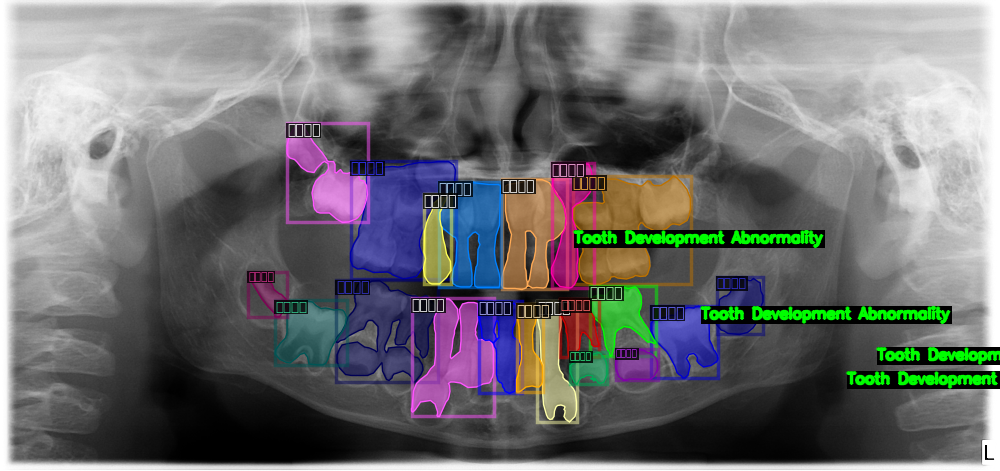

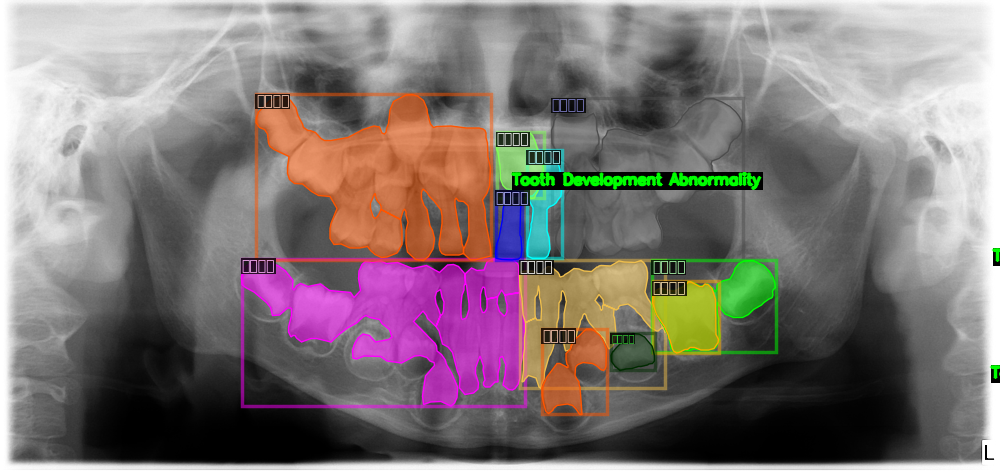

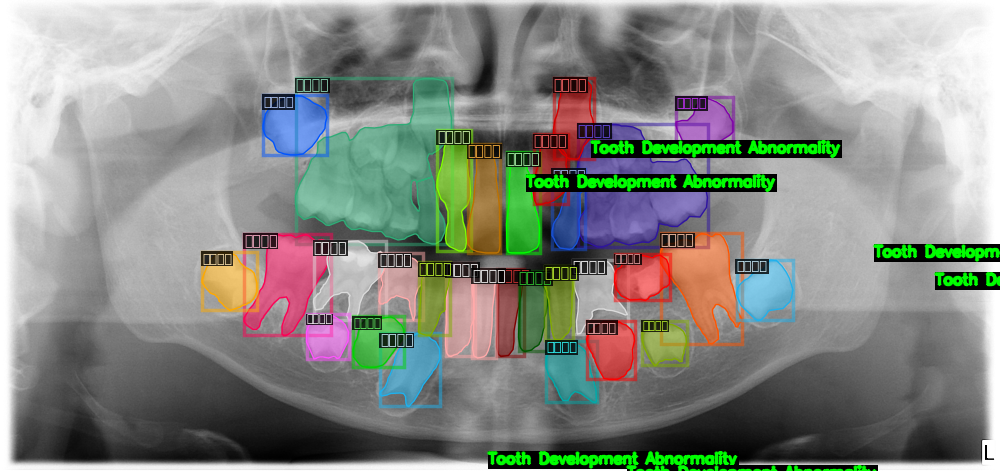

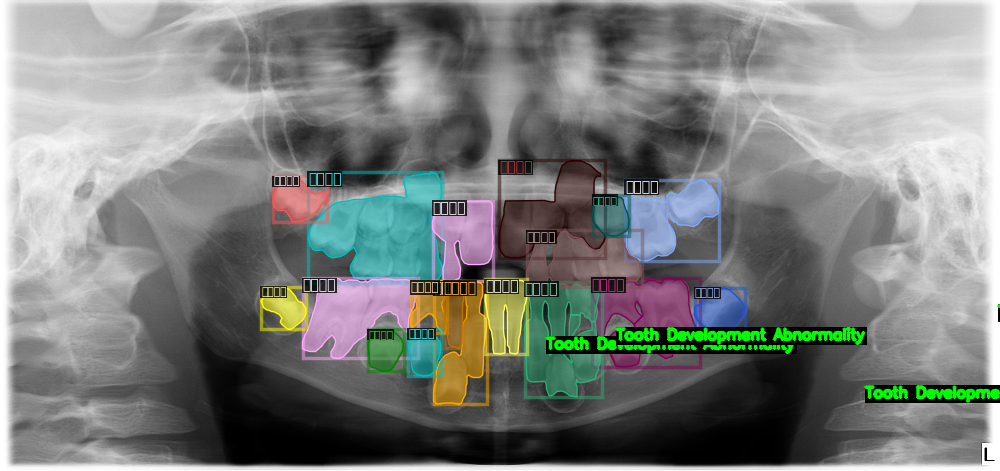

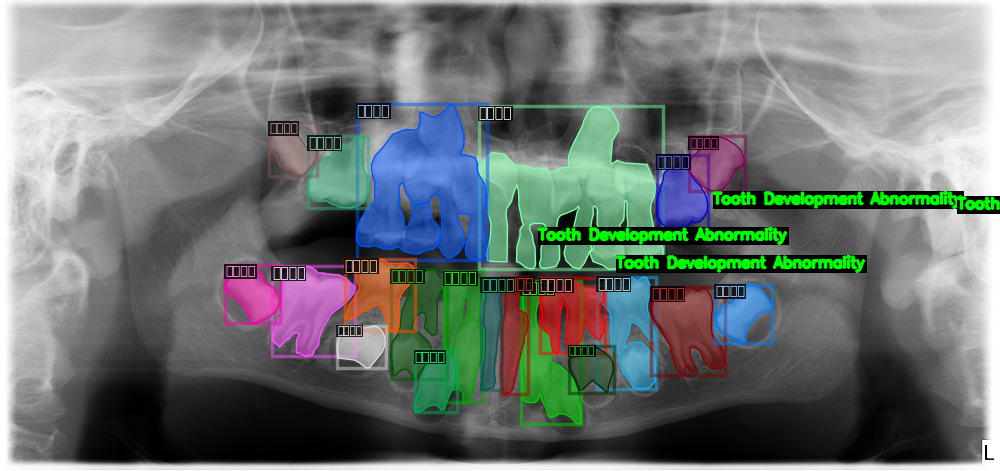

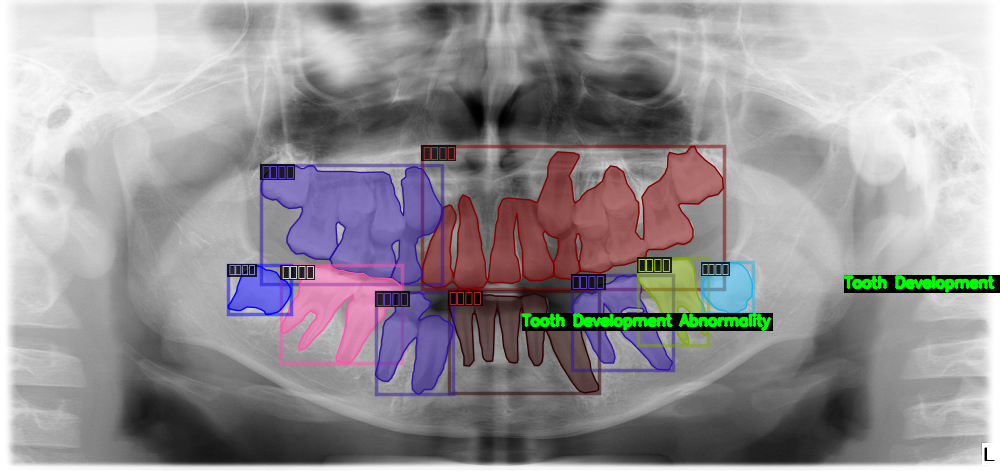

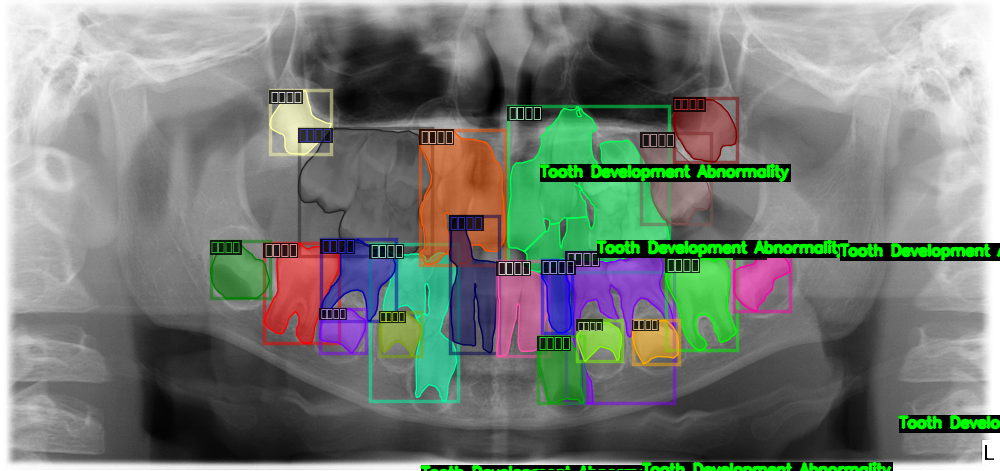

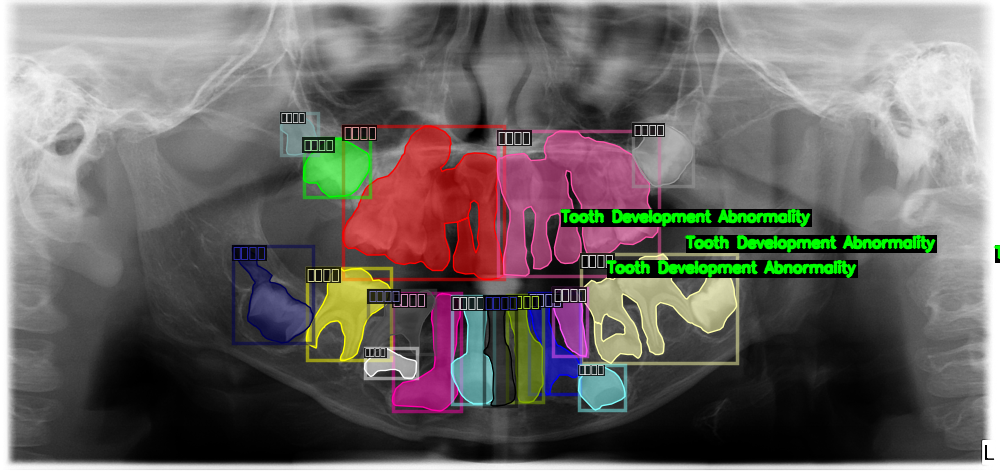

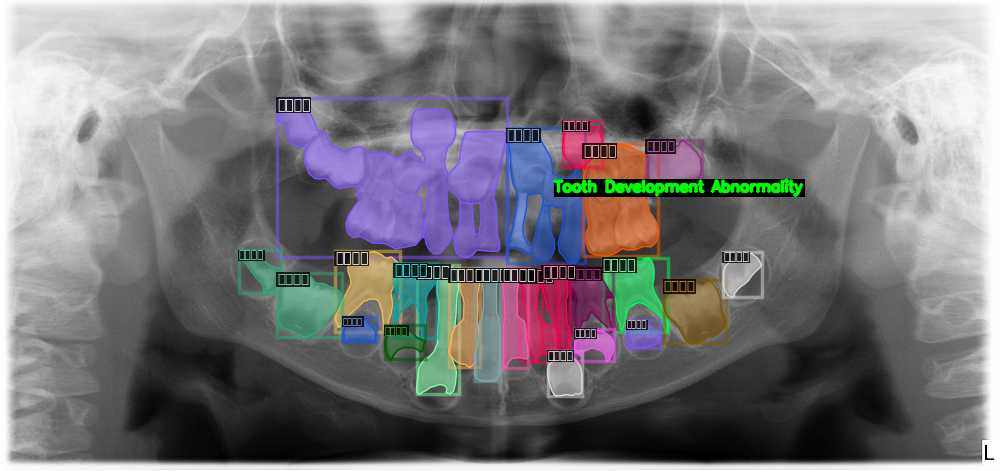

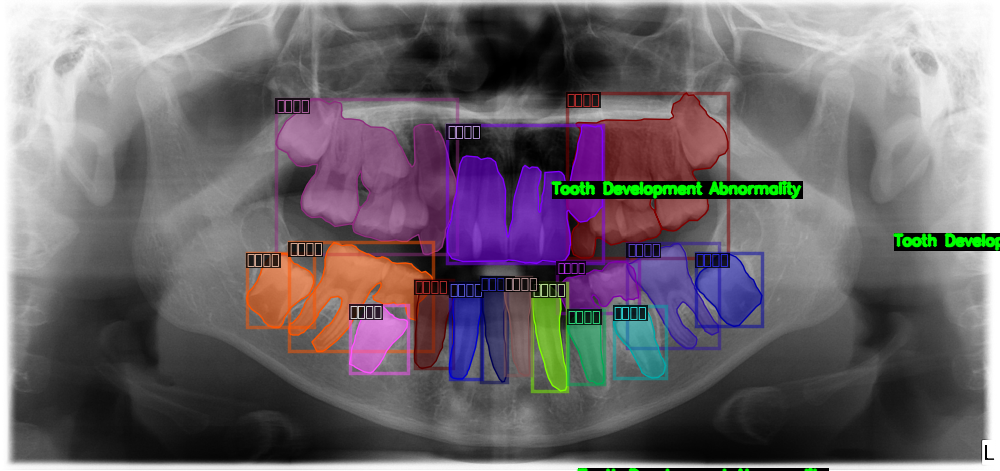

In [10]:
# Visualize with class names mapped during rendering
for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)

    # Draw annotations using the visualizer
    vis = visualizer.draw_dataset_dict(d)
    vis_image = vis.get_image()

    # Convert the image to a compatible format for OpenCV (if needed)
    if isinstance(vis_image, np.ndarray):
        vis_image = vis_image.astype(np.uint8)

    # Add custom class names as text labels using cv2
    for annotation in d["annotations"]:
        category_id = annotation["category_id"]
        class_name = list(CLASS_NAME_MAPPING.values())[category_id]

        # Draw class names on the image
        bbox = annotation["bbox"]
        x, y = int(bbox[0]), int(bbox[1])

        # Define text parameters
        font_scale = 0.5
        font_thickness = 2
        text_size, _ = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, font_scale, font_thickness)
        text_width, text_height = text_size

        # Draw a filled rectangle as background for text for better readability
        cv2.rectangle(
            vis_image,
            (x, y - text_height - 5),  # Top-left corner of the rectangle
            (x + text_width, y),       # Bottom-right corner of the rectangle
            (0, 0, 0),  # Background color (black)
            thickness=cv2.FILLED
        )

        # Put text on top of the filled rectangle
        cv2.putText(
            vis_image,
            class_name,
            (x, y - 5),  # Offset text slightly above the bbox
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (0, 255, 0),  # Green color for text
            font_thickness,
            cv2.LINE_AA
        )

    # Display the final image with bounding boxes and labels
    cv2_imshow(vis_image)


In [11]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 4000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)  # Change this to False
trainer.train()


[10/18 14:20:07 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[10/18 14:20:08 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[10/18 14:20:23 d2.utils.events]:  eta: 0:41:18  iter: 19  total_loss: 3.722  loss_cls: 1.979  loss_box_reg: 0.6851  loss_rpn_cls: 0.873  loss_rpn_loc: 0.1373    time: 0.6338  last_time: 0.6257  data_time: 0.0273  last_data_time: 0.0137   lr: 4.9953e-06  max_mem: 3013M
[10/18 14:20:41 d2.utils.events]:  eta: 0:41:03  iter: 39  total_loss: 3.145  loss_cls: 1.829  loss_box_reg: 0.7958  loss_rpn_cls: 0.3257  loss_rpn_loc: 0.1283    time: 0.6355  last_time: 0.6733  data_time: 0.0117  last_data_time: 0.0166   lr: 9.9902e-06  max_mem: 3013M
[10/18 14:20:54 d2.utils.events]:  eta: 0:40:55  iter: 59  total_loss: 2.747  loss_cls: 1.664  loss_box_reg: 0.8187  loss_rpn_cls: 0.1103  loss_rpn_loc: 0.1192    time: 0.6370  last_time: 0.6376  data_time: 0.0133  last_data_time: 0.0063   lr: 1.4985e-05  max_mem: 3013M
[10/18 14:21:07 d2.utils.events]:  eta: 0:40:51  iter: 79  total_loss: 2.49  loss_cls: 1.442  loss_box_reg: 0.8004  loss_rpn_cls: 0.09524  loss_rpn_loc: 0.1109    time: 0.6402  last_time: 

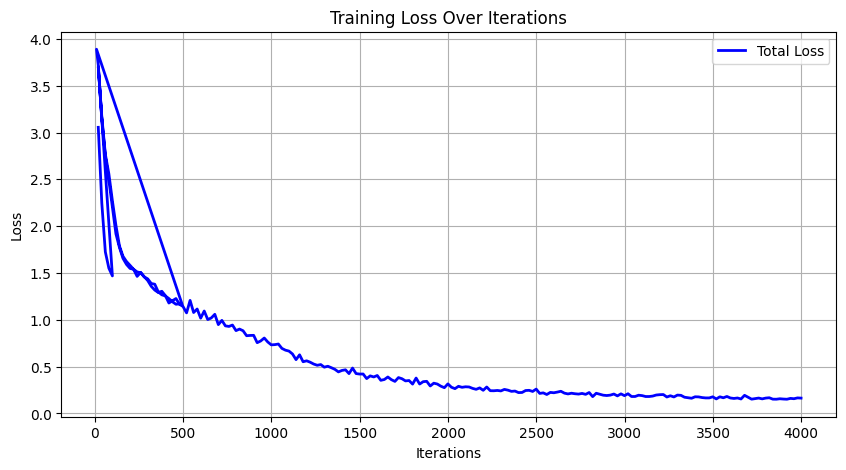

In [14]:
import matplotlib.pyplot as plt
import json
import os

# Path to the metrics JSON file generated during training
metrics_file = os.path.join(cfg.OUTPUT_DIR, "metrics.json")

# Check if the metrics file exists
if os.path.exists(metrics_file):
    # Read the data from the metrics file
    with open(metrics_file, 'r') as f:
        data = [json.loads(line) for line in f]

    # Extract the iteration numbers and total loss values
    iterations = [x['iteration'] for x in data if 'total_loss' in x]
    losses = [x['total_loss'] for x in data if 'total_loss' in x]

    # Plot the training loss
    plt.figure(figsize=(10, 5))
    plt.plot(iterations, losses, label='Total Loss', color='blue', linewidth=2)
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.title('Training Loss Over Iterations')
    plt.grid(True)
    plt.legend()
    plt.show()
else:
    print(f"Metrics file not found at {metrics_file}. Ensure that training has been run.")


In [12]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)

[10/18 15:04:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

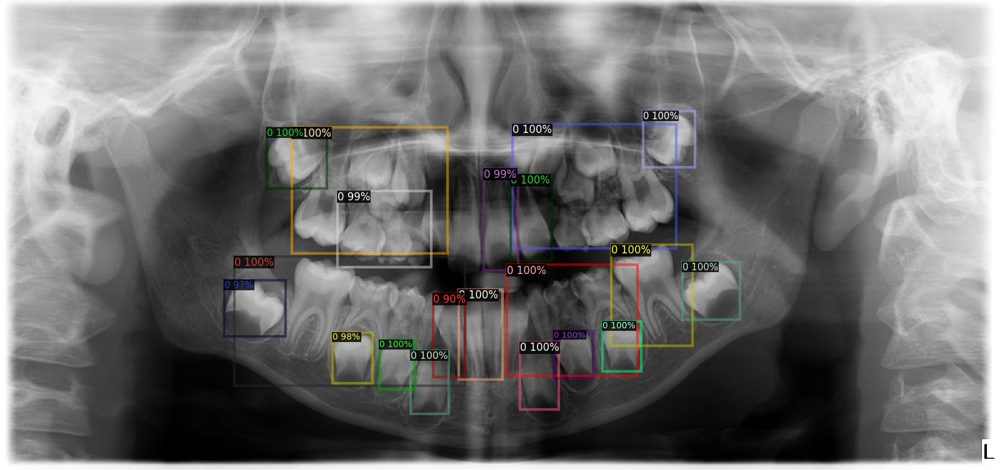

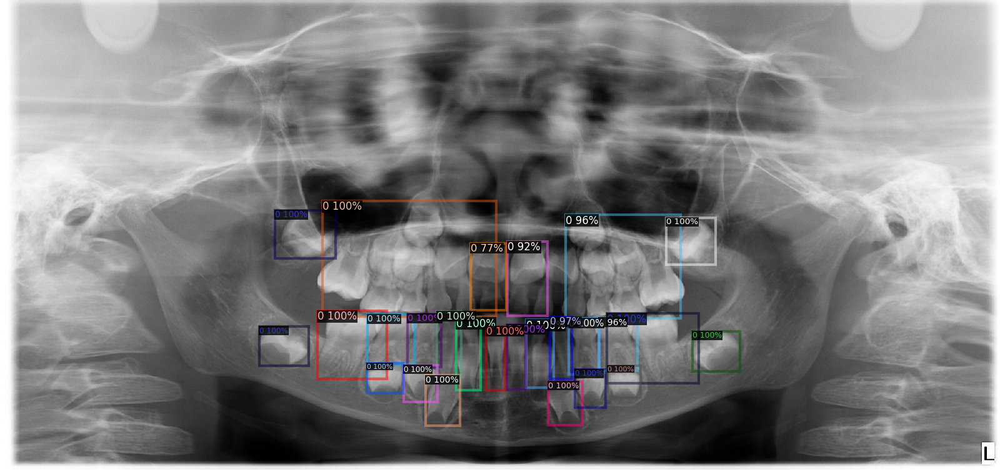

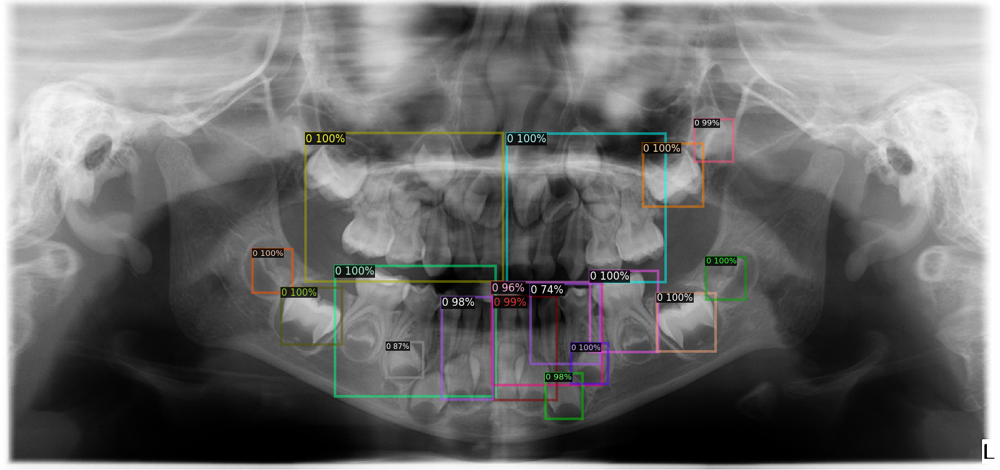

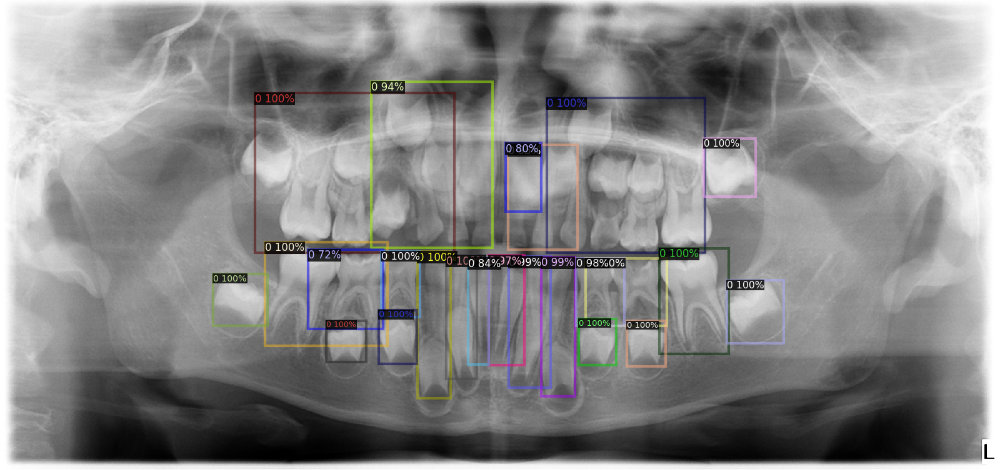

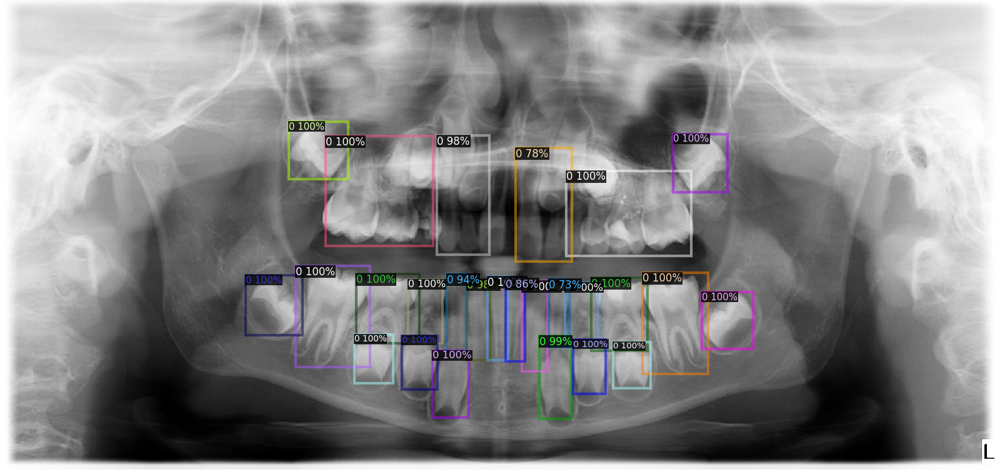

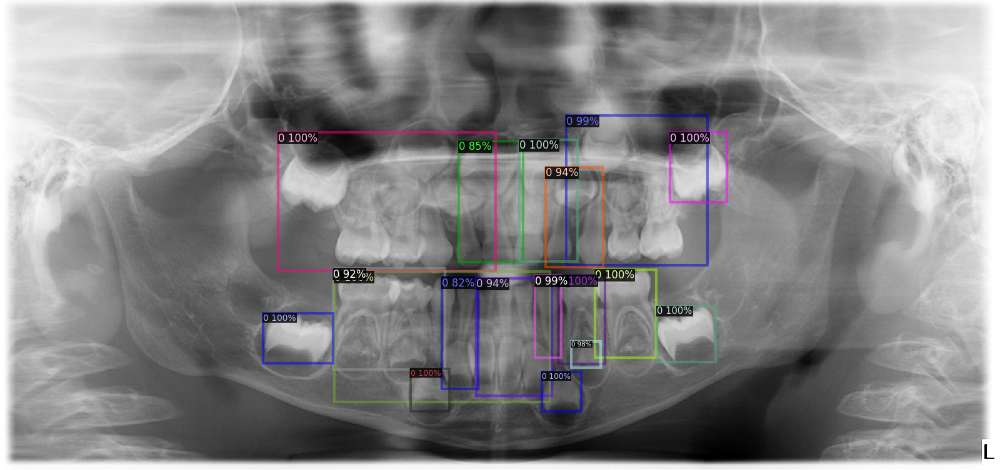

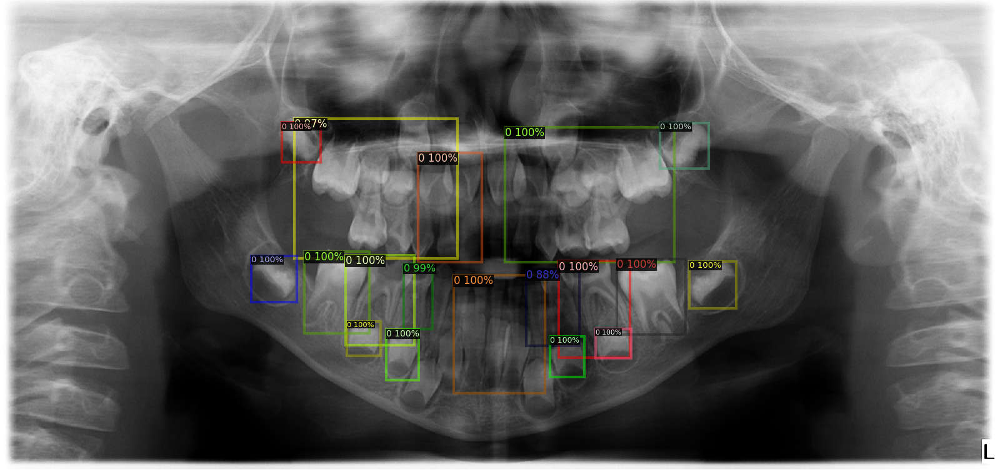

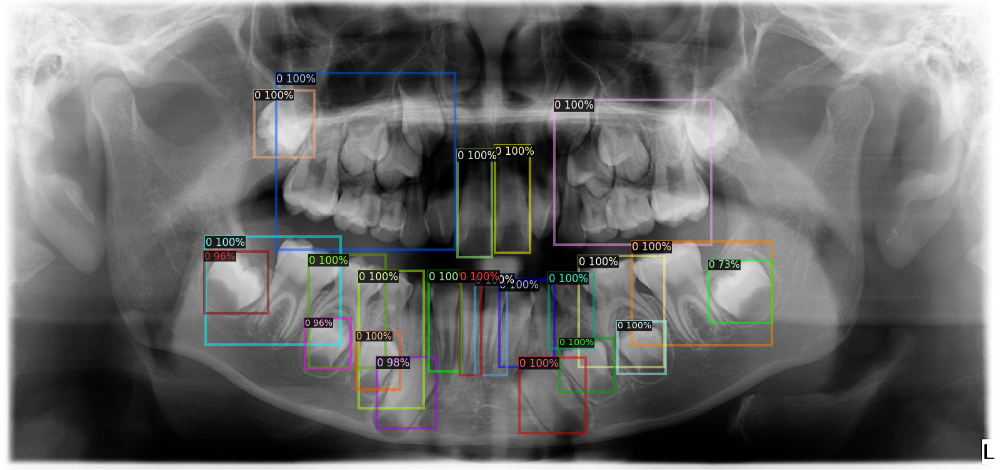

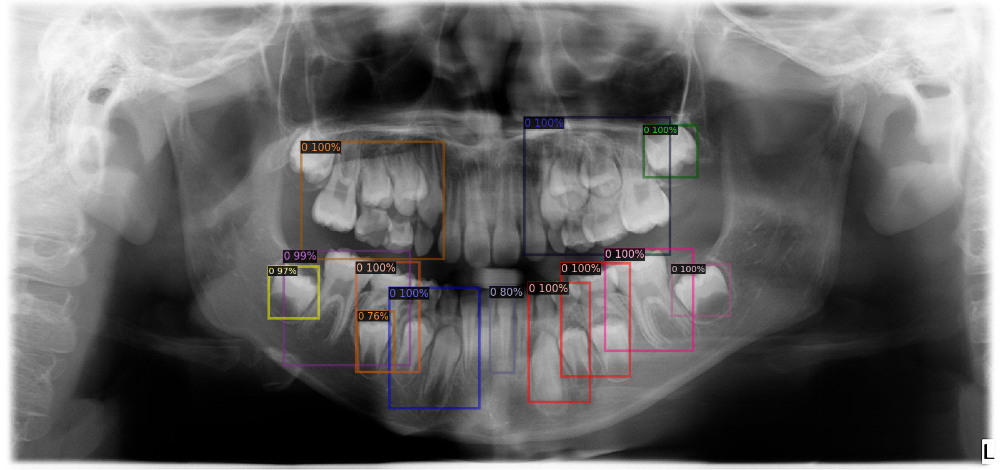

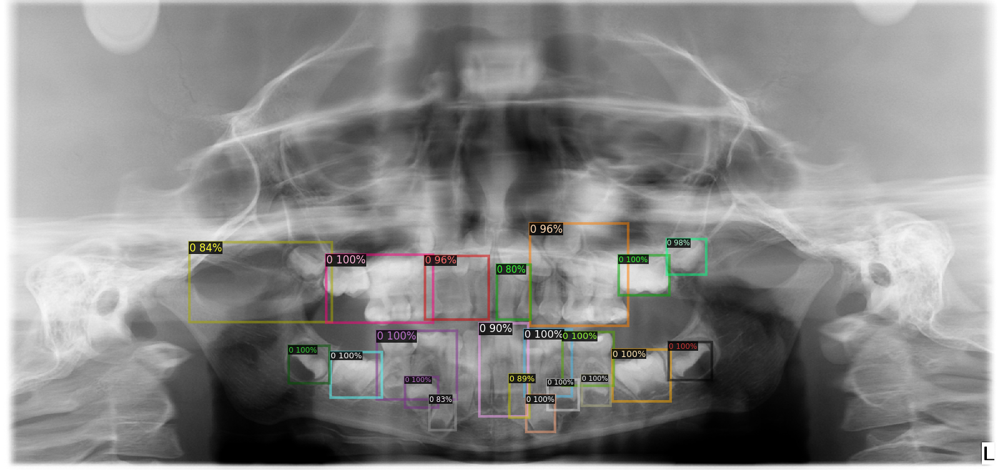

Processed image: /content/Children_Dental/Children's dental caries segmentation dataset/Test/images/cate2_009.png, Predictions: {'instances': Instances(num_instances=23, image_height=942, image_width=2000, fields=[pred_boxes: Boxes(tensor([[1361.3948,  199.9456, 1535.7688,  455.7140],
        [ 461.5173,  458.4846,  699.3365,  681.4604],
        [1117.8147,  525.5995, 1208.0468,  650.9309],
        [1300.8123,  479.0406, 1574.6864,  701.5827],
        [ 764.0989,  619.8691,  845.8949,  737.5780],
        [1073.2213,  513.7443, 1123.7755,  634.4528],
        [1144.6359,  642.8964, 1234.6370,  755.2703],
        [ 502.3404,  118.0889,  927.5235,  462.6066],
        [1274.2560,  252.7526, 1368.9585,  469.4092],
        [1196.3677,  256.5811, 1276.6832,  471.9047],
        [ 832.3566,  670.1663,  928.7092,  822.6526],
        [ 674.2936,  479.9699,  810.9821,  721.7614],
        [1179.8538,  508.4760, 1327.0215,  688.7075],
        [1240.6277,  639.8895, 1340.4834,  752.4838],
        [ 93

In [13]:
from detectron2.utils.visualizer import ColorMode
import glob

# Retrieve all PNG image file paths from the specified directory
image_paths = glob.glob("/content/Children_Dental/Children's dental caries segmentation dataset/Test/images/*png")

# Limit the number of images to visualize
max_images = 10
image_counter = 0

# Process each image in the list
for img_path in image_paths:
    # Load the current image
    image = cv2.imread(img_path)

    # Make predictions using the trained model
    predictions = predictor(image)

    # Check if we need to visualize the current image
    if image_counter < max_images:
        # Create a visualizer for the current image
        visualizer_instance = Visualizer(image[:, :, ::-1],
                                          metadata=MetadataCatalog.get("my_dataset_test"),
                                          scale=0.8
                                          )
        # Draw the predictions on the image
        visualized_output = visualizer_instance.draw_instance_predictions(predictions["instances"].to("cpu"))
        # Display the image with the drawn predictions
        cv2_imshow(visualized_output.get_image()[:, :, ::-1])
        image_counter += 1
    else:
        # For images beyond the limit, print the predictions
        print(f"Processed image: {img_path}, Predictions: {predictions}")
